In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [2]:
# Load data
MRT_DF = pd.read_csv('../../data/oralytics_mrt_data.csv')
# filter for non-NaN values
MRT_DF = MRT_DF[MRT_DF['viability'] == 1]
ACTION_SELECTION_DF = pd.read_csv('../../data/action_selection_data_table.csv')
UPDATE_DF = pd.read_csv('../../data/update_data_table.csv')
POSTERIOR_DF = pd.read_csv('../../data/posterior_weights_table.csv')
MRT_USERS = MRT_DF['user_id'].unique().tolist()

## Helper Functions
---

In [3]:
def get_user_data(df, user_id):
  return df[df['user_id'] == user_id]

# used for calculating forecasts
def get_user_action_selection_data(user_id):
  user_df = get_user_data(ACTION_SELECTION_DF, user_id)
  return user_df[(user_df["user_decision_t"] < 140) & (user_df["policy_idx"] >= 0)]

### GETTING STATES ###
def get_adv_state(row):
  return np.array(row[['state_tod', 'state_b_bar', 'state_a_bar', 'state_app_engage', 'state_bias']].values, dtype=np.float64)

### GETTING POSTERIOR ###
D_ADVANTAGE = 5
RL_ALG_FEATURE_DIM = 15
def get_posterior_values(policy_idx):
  row = POSTERIOR_DF[POSTERIOR_DF['policy_idx'] == policy_idx]
  row_vals = np.array(row.iloc[:, 3:].values).reshape(-1, 1)
  beta_mean = row_vals[:RL_ALG_FEATURE_DIM][-D_ADVANTAGE:]
  beta_var = row_vals[RL_ALG_FEATURE_DIM:].reshape(RL_ALG_FEATURE_DIM, RL_ALG_FEATURE_DIM)[-D_ADVANTAGE:,-D_ADVANTAGE:]

  return beta_mean, beta_var

import scipy.stats as stats
from scipy.special import expit

### SMOOTHING FUNCTION ###
L_min = 0.2
L_max = 0.8
# larger values of b > 0 makes curve more "steep"
B_logistic = 0.515
# larger values of c > 0 shifts the value of function(0) to the right
C_logistic = 3
# larger values of k > 0 makes the asmptote towards upper clipping less steep
# and the asymptote towards the lower clipping more steep
K_logistic = 1

def genearlized_logistic_func(x):
    num = L_max - L_min
    stable_exp = expit(B_logistic * x - np.log(C_logistic))
    stable_exp_k = stable_exp**K_logistic

    return L_min + num * stable_exp_k

def compute_probability(beta_post_mean, beta_post_var, advantage_state):
  # using the genearlized_logistic_func, probabilities are already clipped to asymptotes
  mu = advantage_state @ beta_post_mean
  std = np.sqrt(advantage_state @ beta_post_var @ advantage_state.T)
  posterior_prob = stats.norm.expect(func=genearlized_logistic_func, loc=mu, scale=std)

  return posterior_prob

In [4]:
# this is a modification of Equation (3) in https://arxiv.org/pdf/2304.05365
def calculate_interesting_score(probs_for_state_1, probs_for_state_0):
    return len(probs_for_state_1[np.where(probs_for_state_1 > probs_for_state_0)]) / len(probs_for_state_1)

## Interesting Scores
---

For binary feature values:
$$
\text{score\_int}_z(i) := \frac{\sum_{t = 1}^T \mathbb{I}[\hat{\pi}_{i, t}(S_{i, t}(z = 1)) > \hat{\pi}_{i, t}(S_{i, t}(z = 0))]}{T}    
$$

For real-valued features:
$$
\text{score\_int}_z(i) := \frac{\sum_{t = 1}^T \mathbb{I}[\hat{\pi}_{i, t}(S_{i, t}) > \hat{\pi}_{i, t}(S_{i, t}(z = 0))]}{T} 
$$

### State - Time of Day

In [5]:
# for state_tod
def calculate_interesting_score_state_tod():
    result = {}
    for user_id in MRT_USERS:
        print(f"for {user_id}")
        forecast_user_df = get_user_action_selection_data(user_id)
        probs_for_state_1 = []
        probs_for_state_0 = []

        for _, row in forecast_user_df.iterrows():
            policy_idx = row['policy_idx']
            beta_mean, beta_var = get_posterior_values(policy_idx)
            state = get_adv_state(row)
            counter_factual_state = state.copy()
            # specific to feature time of day
            if state[0] == 0:
                counter_factual_state[0] = 1
                probs_for_state_1.append(compute_probability(beta_mean, beta_var, counter_factual_state))
                probs_for_state_0.append(compute_probability(beta_mean, beta_var, state))
            else:
                counter_factual_state[0] = 0
                probs_for_state_1.append(compute_probability(beta_mean, beta_var, state))
                probs_for_state_0.append(compute_probability(beta_mean, beta_var, counter_factual_state))

        score = calculate_interesting_score(np.array(probs_for_state_1), np.array(probs_for_state_0))
        result[user_id] = score

    return result

In [6]:
state_tod_scores = calculate_interesting_score_state_tod()
state_tod_scores_df = pd.DataFrame(list(state_tod_scores.items()), columns=['user_id', 'state_tod score'])
state_tod_scores_df.to_csv('../../Results/state_tod_scores.csv', index=False)

for robas+119@developers.pg.com
for robas+126@developers.pg.com
for digitaldentalcoach+214@gmail.com
for robas+135@developers.pg.com
for robas+199@developers.pg.com
for robas+120@developers.pg.com
for digitaldentalcoach+243@gmail.com
for robas+169@developers.pg.com
for robas+137@developers.pg.com
for robas+128@developers.pg.com
for digitaldentalcoach+238@gmail.com
for robas+153@developers.pg.com
for digitaldentalcoach+217@gmail.com
for digitaldentalcoach+240@gmail.com
for digitaldentalcoach+222@gmail.com
for digitaldentalcoach+212@gmail.com
for robas+171@developers.pg.com
for digitaldentalcoach+218@gmail.com
for robas+146@developers.pg.com
for digitaldentalcoach+219@gmail.com
for robas+178@developers.pg.com
for robas+132@developers.pg.com
for digitaldentalcoach+225@gmail.com
for digitaldentalcoach+239@gmail.com
for robas+173@developers.pg.com
for digitaldentalcoach+232@gmail.com
for robas+130@developers.pg.com
for robas+182@developers.pg.com
for robas+172@developers.pg.com
for robas+15

### State - App Engagement

In [7]:
# for app_engage
def calculate_interesting_score_state_app_engage():
    result = {}
    for user_id in MRT_USERS:
        print(f"for {user_id}")
        forecast_user_df = get_user_action_selection_data(user_id)
        probs_for_state_1 = []
        probs_for_state_0 = []

        for _, row in forecast_user_df.iterrows():
            policy_idx = row['policy_idx']
            beta_mean, beta_var = get_posterior_values(policy_idx)
            state = get_adv_state(row)
            counter_factual_state = state.copy()
            # specific to feature prior day app engage
            if state[3] == 0:
                counter_factual_state[3] = 1
                probs_for_state_1.append(compute_probability(beta_mean, beta_var, counter_factual_state))
                probs_for_state_0.append(compute_probability(beta_mean, beta_var, state))
            else:
                counter_factual_state[3] = 0
                probs_for_state_1.append(compute_probability(beta_mean, beta_var, state))
                probs_for_state_0.append(compute_probability(beta_mean, beta_var, counter_factual_state))

        score = calculate_interesting_score(np.array(probs_for_state_1), np.array(probs_for_state_0))
        result[user_id] = score

    return result

In [8]:
state_app_engage_scores = calculate_interesting_score_state_app_engage()

for robas+119@developers.pg.com
for robas+126@developers.pg.com
for digitaldentalcoach+214@gmail.com
for robas+135@developers.pg.com
for robas+199@developers.pg.com
for robas+120@developers.pg.com
for digitaldentalcoach+243@gmail.com
for robas+169@developers.pg.com
for robas+137@developers.pg.com
for robas+128@developers.pg.com
for digitaldentalcoach+238@gmail.com
for robas+153@developers.pg.com
for digitaldentalcoach+217@gmail.com
for digitaldentalcoach+240@gmail.com
for digitaldentalcoach+222@gmail.com
for digitaldentalcoach+212@gmail.com
for robas+171@developers.pg.com
for digitaldentalcoach+218@gmail.com
for robas+146@developers.pg.com
for digitaldentalcoach+219@gmail.com
for robas+178@developers.pg.com
for robas+132@developers.pg.com
for digitaldentalcoach+225@gmail.com
for digitaldentalcoach+239@gmail.com
for robas+173@developers.pg.com
for digitaldentalcoach+232@gmail.com
for robas+130@developers.pg.com
for robas+182@developers.pg.com
for robas+172@developers.pg.com
for robas+15

In [9]:
state_app_engage_scores_df = pd.DataFrame(list(state_app_engage_scores.items()), columns=['user_id', 'state_app_engage score'])

In [10]:
state_app_engage_scores_df.to_csv('../../Results/state_app_engage_scores.csv', index=False)

### State - B_bar
Since b_bar achieves a non-binary value between [-1, 1], to calculate the interestingness score with respect to a counterfactual value, we contrast the b_bar value that was observed with b_bar = 0 which represent an average value.

In [11]:
# for app_engage
def calculate_interesting_score_state_b_bar():
    result = {}
    for user_id in MRT_USERS:
        print(f"for {user_id}")
        forecast_user_df = get_user_action_selection_data(user_id)
        probs_for_state_1 = []
        probs_for_state_0 = []

        for _, row in forecast_user_df.iterrows():
            policy_idx = row['policy_idx']
            beta_mean, beta_var = get_posterior_values(policy_idx)
            state = get_adv_state(row)
            counter_factual_state = state.copy()
            # specific to feature b_bar
            counter_factual_state[1] = 0
            probs_for_state_1.append(compute_probability(beta_mean, beta_var, state))
            probs_for_state_0.append(compute_probability(beta_mean, beta_var, counter_factual_state))

        score = calculate_interesting_score(np.array(probs_for_state_1), np.array(probs_for_state_0))
        result[user_id] = score

    return result

In [12]:
state_b_bar_scores = calculate_interesting_score_state_b_bar()
state_b_bar_scores_df = pd.DataFrame(list(state_b_bar_scores.items()), columns=['user_id', 'state_b_bar score'])
state_b_bar_scores_df.to_csv('../../Results/state_b_bar_scores.csv', index=False)

for robas+119@developers.pg.com
for robas+126@developers.pg.com
for digitaldentalcoach+214@gmail.com
for robas+135@developers.pg.com
for robas+199@developers.pg.com
for robas+120@developers.pg.com
for digitaldentalcoach+243@gmail.com
for robas+169@developers.pg.com
for robas+137@developers.pg.com
for robas+128@developers.pg.com
for digitaldentalcoach+238@gmail.com
for robas+153@developers.pg.com
for digitaldentalcoach+217@gmail.com
for digitaldentalcoach+240@gmail.com
for digitaldentalcoach+222@gmail.com
for digitaldentalcoach+212@gmail.com
for robas+171@developers.pg.com
for digitaldentalcoach+218@gmail.com
for robas+146@developers.pg.com
for digitaldentalcoach+219@gmail.com
for robas+178@developers.pg.com
for robas+132@developers.pg.com
for digitaldentalcoach+225@gmail.com
for digitaldentalcoach+239@gmail.com
for robas+173@developers.pg.com
for digitaldentalcoach+232@gmail.com
for robas+130@developers.pg.com
for robas+182@developers.pg.com
for robas+172@developers.pg.com
for robas+15

### State - A_bar
Since a_bar achieves a non-binary value between [-1, 1], to calculate the interestingness score with respect to a counterfactual value, we contrast the a_bar value that was observed with a_bar = 0 which represent an average value.

In [13]:
# for app_engage
def calculate_interesting_score_state_a_bar():
    result = {}
    for user_id in MRT_USERS:
        print(f"for {user_id}")
        forecast_user_df = get_user_action_selection_data(user_id)
        probs_for_state_1 = []
        probs_for_state_0 = []

        for _, row in forecast_user_df.iterrows():
            policy_idx = row['policy_idx']
            beta_mean, beta_var = get_posterior_values(policy_idx)
            state = get_adv_state(row)
            counter_factual_state = state.copy()
            # specific to feature a_bar
            counter_factual_state[2] = 0
            probs_for_state_1.append(compute_probability(beta_mean, beta_var, state))
            probs_for_state_0.append(compute_probability(beta_mean, beta_var, counter_factual_state))

        score = calculate_interesting_score(np.array(probs_for_state_1), np.array(probs_for_state_0))
        result[user_id] = score

    return result

In [14]:
state_a_bar_scores = calculate_interesting_score_state_a_bar()
state_a_bar_scores_df = pd.DataFrame(list(state_a_bar_scores.items()), columns=['user_id', 'state_a_bar score'])
state_a_bar_scores_df.to_csv('../../Results/state_a_bar_scores.csv', index=False)

for robas+119@developers.pg.com
for robas+126@developers.pg.com
for digitaldentalcoach+214@gmail.com
for robas+135@developers.pg.com
for robas+199@developers.pg.com
for robas+120@developers.pg.com
for digitaldentalcoach+243@gmail.com
for robas+169@developers.pg.com
for robas+137@developers.pg.com
for robas+128@developers.pg.com
for digitaldentalcoach+238@gmail.com
for robas+153@developers.pg.com
for digitaldentalcoach+217@gmail.com
for digitaldentalcoach+240@gmail.com
for digitaldentalcoach+222@gmail.com
for digitaldentalcoach+212@gmail.com
for robas+171@developers.pg.com
for digitaldentalcoach+218@gmail.com
for robas+146@developers.pg.com
for digitaldentalcoach+219@gmail.com
for robas+178@developers.pg.com
for robas+132@developers.pg.com
for digitaldentalcoach+225@gmail.com
for digitaldentalcoach+239@gmail.com
for robas+173@developers.pg.com
for digitaldentalcoach+232@gmail.com
for robas+130@developers.pg.com
for robas+182@developers.pg.com
for robas+172@developers.pg.com
for robas+15

### Calculating Num. Interesting Participant-State Graphs
---

In [28]:
DELTA = 0.4

def calculate_num_interesting_scores(scores):
    interesting_scores = scores[np.where(np.abs(scores - 0.5) >= DELTA)]
    return len(interesting_scores)

In [29]:
# state tod
tod_scores = pd.read_csv('../../Results/state_tod_scores.csv')['state_tod score'].tolist()
num_interesting_scores = calculate_num_interesting_scores(np.array(tod_scores))
print(f"Num. interesting scores for feature time of day: {num_interesting_scores}")
# state prior day app engage
state_app_engage_scores = pd.read_csv('../../Results/state_app_engage_scores.csv')['state_app_engage score'].tolist()
num_interesting_scores = calculate_num_interesting_scores(np.array(state_app_engage_scores))
print(f"Num. interesting scores for feature prior day app engagement: {num_interesting_scores}")
# state b_bar
state_b_bar_scores = pd.read_csv('../../Results/state_b_bar_scores.csv')['state_b_bar score'].tolist()
num_interesting_scores = calculate_num_interesting_scores(np.array(state_b_bar_scores))
print(f"Num. interesting scores for feature b_bar: {num_interesting_scores}")
# state a_bar
state_a_bar_scores = pd.read_csv('../../Results/state_a_bar_scores.csv')['state_a_bar score'].tolist()
num_interesting_scores = calculate_num_interesting_scores(np.array(state_a_bar_scores))
print(f"Num. interesting scores for feature a_bar: {num_interesting_scores}")

Num. interesting scores for feature time of day: 59
Num. interesting scores for feature prior day app engagement: 58
Num. interesting scores for feature b_bar: 50
Num. interesting scores for feature a_bar: 16


## Interesting Graphs
---
Recall the non-intercept states are:
1. time of day (binary)
2. b_bar (real-valued between [-1, 1])
3. a_bar (real-valued between [-1, 1])
4. prior day app engagement (binary)

In [184]:
import shutil
import os

### Binary Features

In [129]:
def plot_interesting_graph_binary(user_id, dates, state_values, probs, save_file_name):
    # Colors based on variation: blue for 0, red for 1
    colors = ['blue' if var == 0 else 'red' for var in state_values]
    markers = ['o' if var == 0 else '^' for var in state_values]

    # Plotting
    plt.figure(figsize=(8, 6))  # Specify figure size (width, height) in inches

    # Plot points where variation = 0 (blue circles)
    plt.scatter([dates[i] for i in range(len(state_values)) if state_values[i] == 0],
                [probs[i] for i in range(len(state_values)) if state_values[i] == 0],
                color='blue', marker='o', label='Variation 0', s=100, alpha=0.75)

    # Plot points where variation = 1 (red triangles)
    plt.scatter([dates[i] for i in range(len(state_values)) if state_values[i] == 1],
                [probs[i] for i in range(len(state_values)) if state_values[i] == 1],
                color='red', marker='^', label='Variation 1', s=100, alpha=0.75)
    
    plt.xlabel('Date', size=15)  # Label for x-axis
    plt.ylabel('Action-Selection Probability', size=15)  # Label for y-axis
    plt.title(f'{user_id}', size=20)  # Title of the plot
    plt.legend(loc='best')

    plt.xticks(rotation=45, ha='right', size=15)  # Rotate labels for better readability
    # Add dotted black line at y=0.5
    plt.axhline(y=0.5, color='black', linestyle='--')

    plt.tight_layout()
    plt.savefig(save_file_name)

/var/folders/9n/sg342nsx01v38v7zgp161khr0000gn/T/ipykernel_38619/4133545976.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_user_df['decision_time'] = pd.to_datetime(test_user_df['decision_time'])


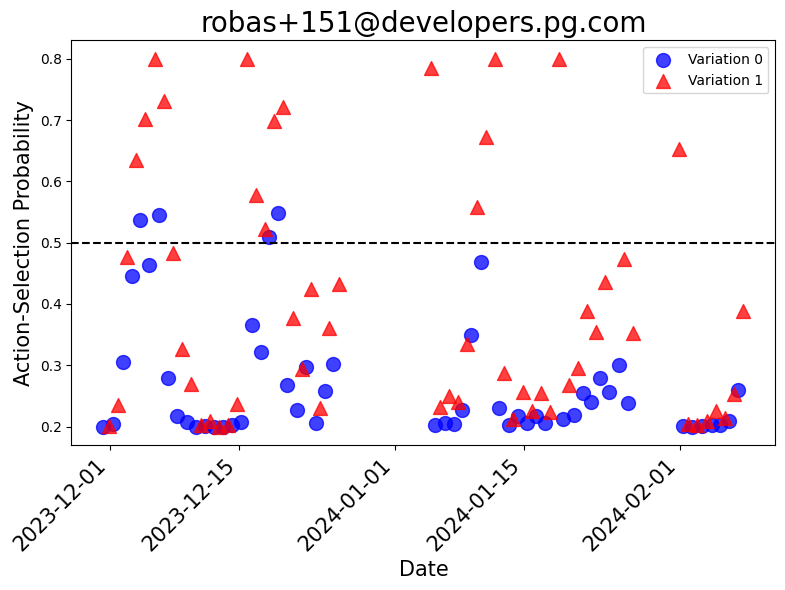

In [131]:
# TEST
test_user = "robas+151@developers.pg.com"
test_user_df = get_user_data(MRT_DF, test_user)
test_user_df['decision_time'] = pd.to_datetime(test_user_df['decision_time'])
test_user_df = test_user_df[test_user_df['state_modif'] != 8]
dates = test_user_df['decision_time'].tolist()
state_values = test_user_df['state_tod'].tolist()
probs = test_user_df['prob'].tolist()
plot_interesting_graph_binary(test_user, dates, state_values, probs, f'../../figs/state_tod_plots/state_tod_{test_user}.pdf')

### Generate Graphs
---

/var/folders/9n/sg342nsx01v38v7zgp161khr0000gn/T/ipykernel_38619/3470044266.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))  # Specify figure size (width, height) in inches


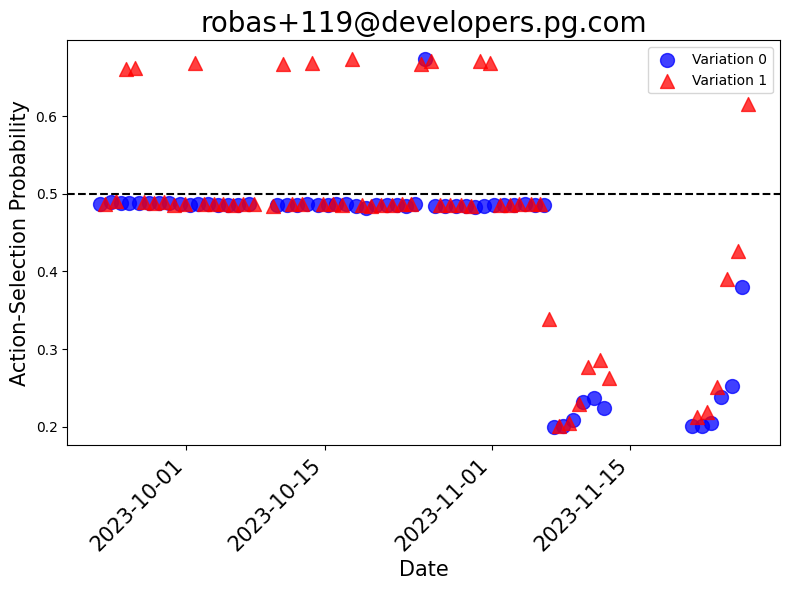

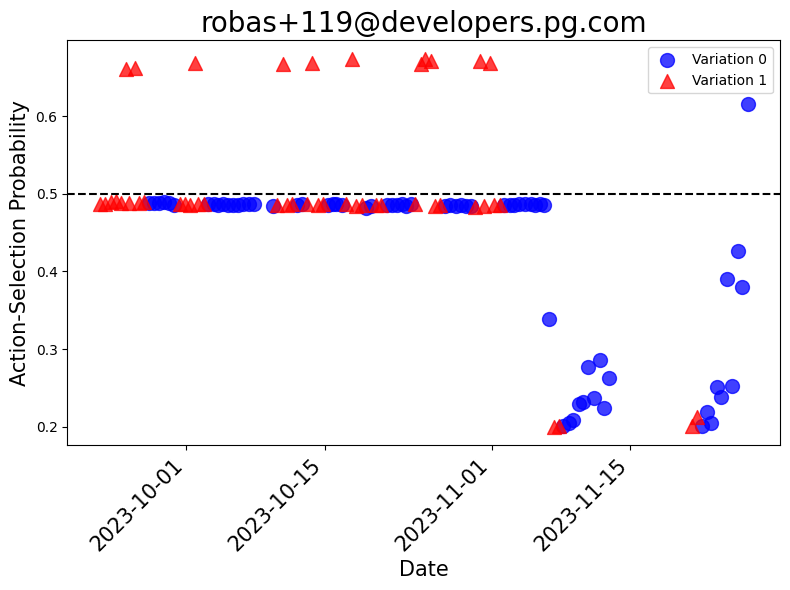

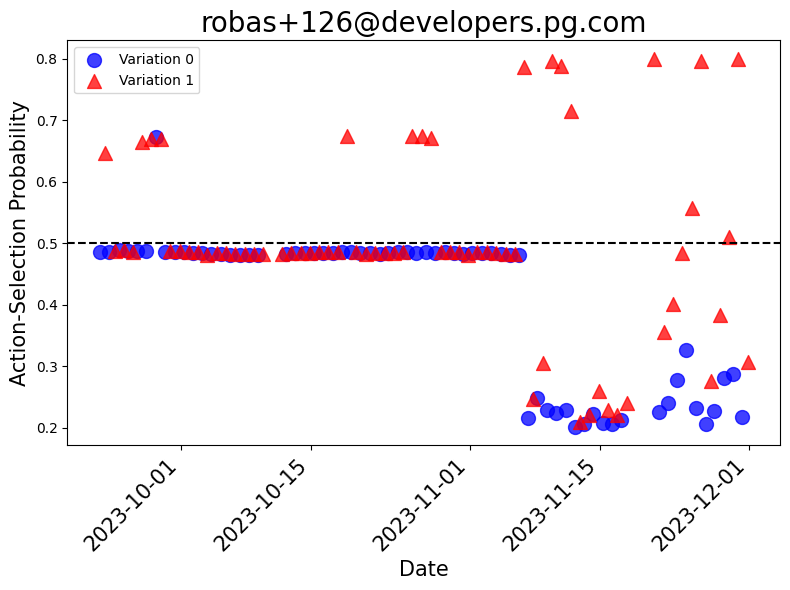

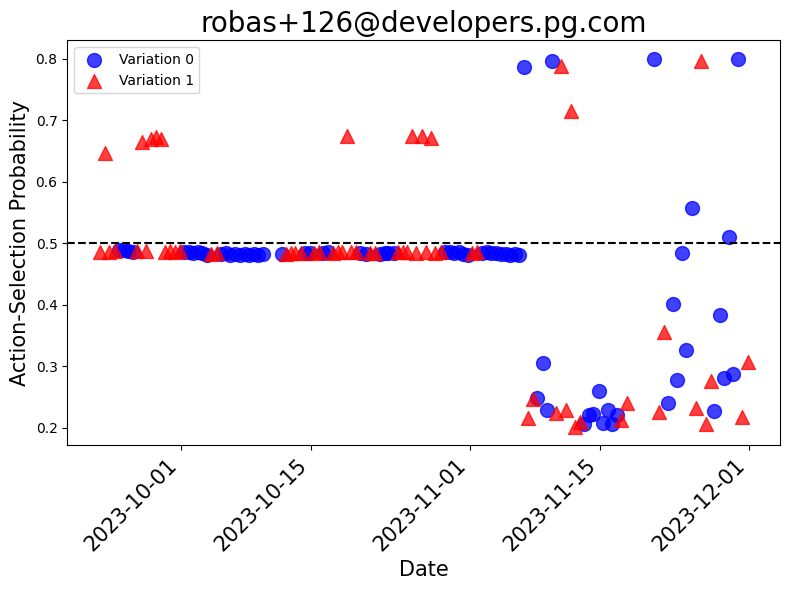

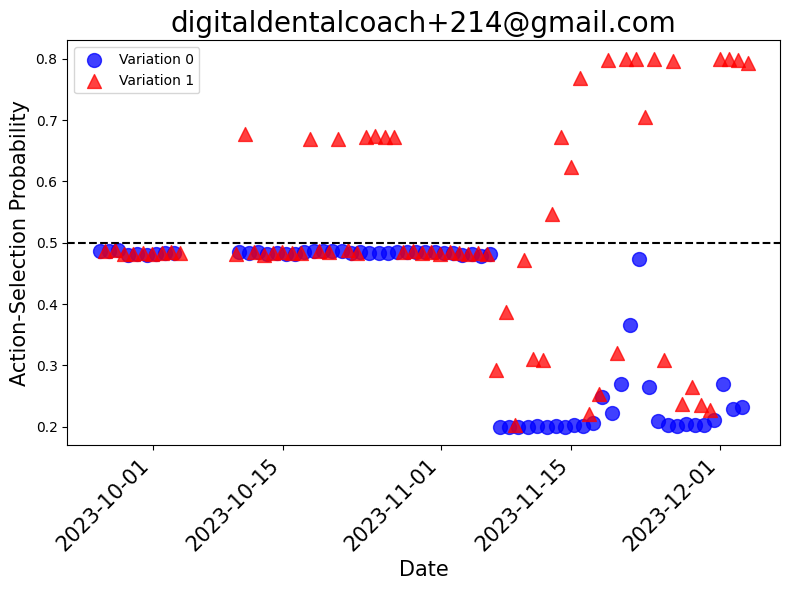

...

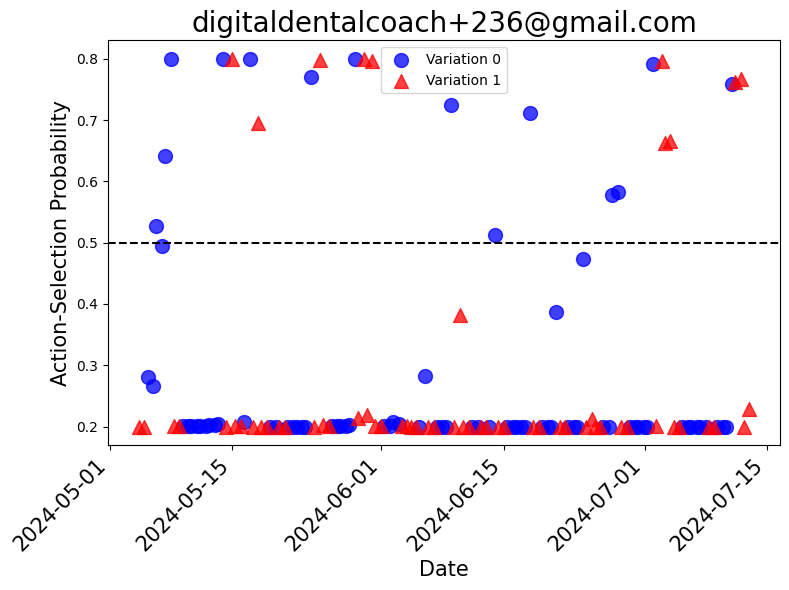

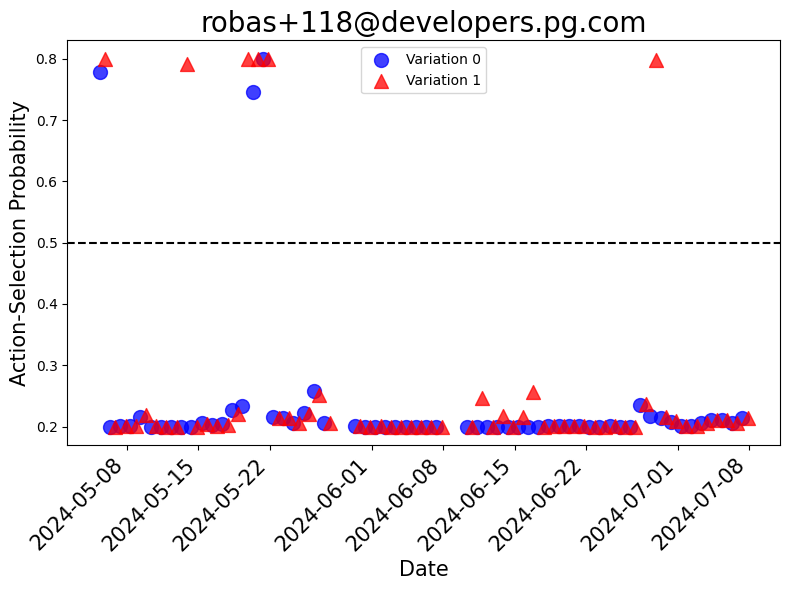

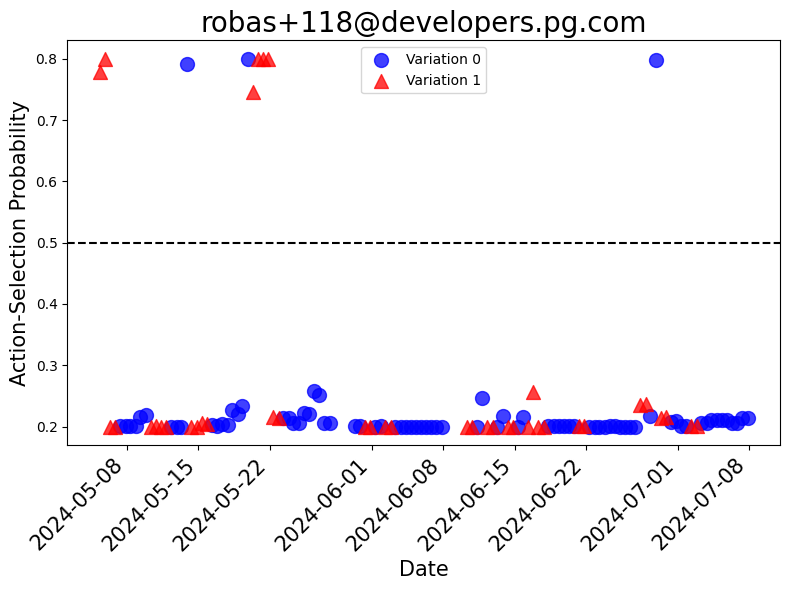

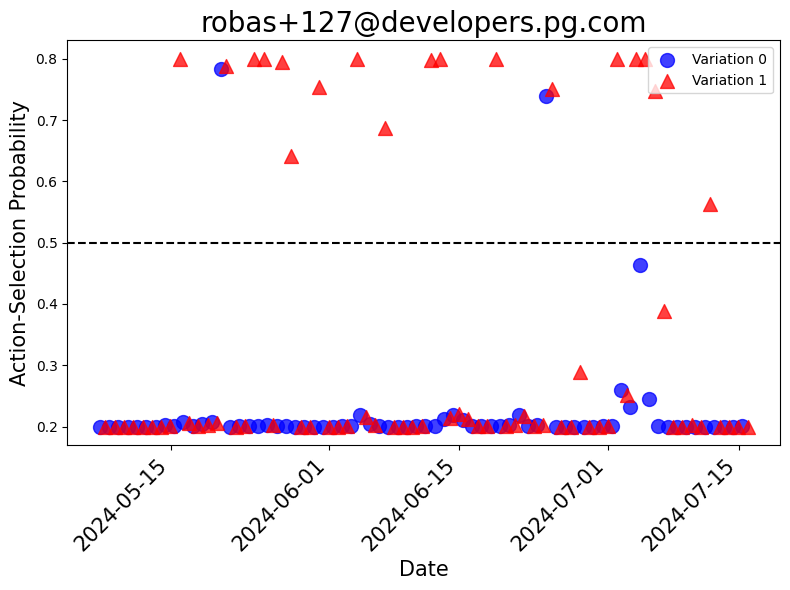

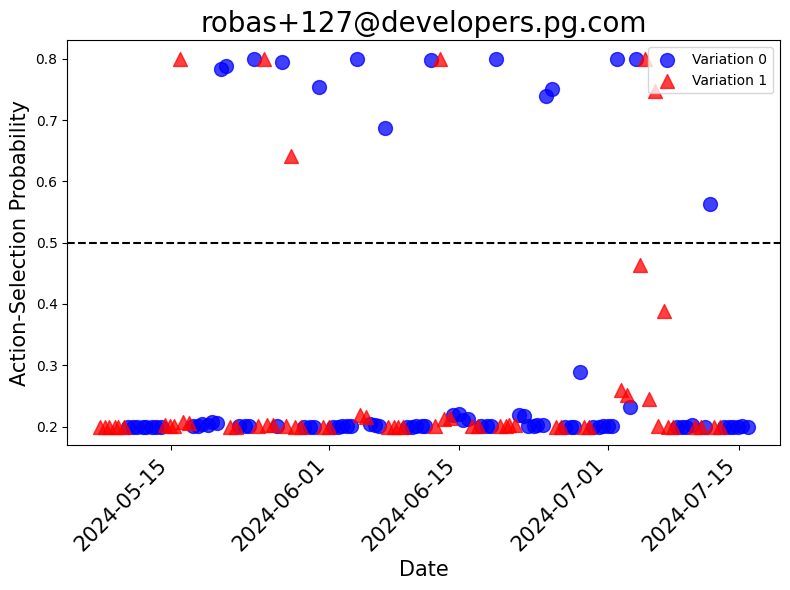

In [132]:
for user_id in MRT_USERS:
    user_df = get_user_data(MRT_DF, user_id)
    # filter for actions actually selected by the RL algorithm and not fallback fixed prob.
    user_df = user_df[user_df['state_modif'] != 8]
    user_df['decision_time'] = pd.to_datetime(user_df['decision_time'])
    dates = user_df['decision_time'].tolist()
    state_values = user_df['state_tod'].tolist()
    state_app_values = user_df['state_app_engage'].tolist()
    probs = user_df['prob'].tolist()
    plot_interesting_graph_binary(user_id, dates, state_values, probs, f'../../figs/state_tod_plots/state_tod_{user_id}.pdf')
    plot_interesting_graph_binary(user_id, dates, state_app_values, probs, f'../../figs/state_app_engage_plots/state_app_engage_{user_id}.pdf')

### Anna Comments
---

In [185]:
# Anna after manually checking
tod_ig_users = ['robas+127@developers.pg.com', 'digitaldentalcoach+236@gmail.com', 'digitaldentalcoach+271@gmail.com', 'digitaldentalcoach+249@gmail.com', 'robas+168@developers.pg.com', 'digitaldentalcoach+209@gmail.com', 'robas+160@developers.pg.com', 'robas+156@developers.pg.com', 'robas+181@developers.pg.com', 'robas+152@developers.pg.com', 'robas+139@developers.pg.com', 'robas+167@developers.pg.com', 'robas+166@developers.pg.com', 'digitaldentalcoach+211@gmail.com', 'digitaldentalcoach+230@gmail.com', 'robas+170@developers.pg.com', 'robas+174@developers.pg.com', 'robas+140@developers.pg.com', 'digitaldentalcoach+208@gmail.com', 'robas+143@developers.pg.com', 'robas+129@developers.pg.com', 'digitaldentalcoach+224@gmail.com', 'digitaldentalcoach+267@gmail.com', 'digitaldentalcoach+233@gmail.com', 'digitaldentalcoach+213@gmail.com', 'robas+154@developers.pg.com', 'robas+151@developers.pg.com', 'robas+172@developers.pg.com', 'robas+182@developers.pg.com', 'digitaldentalcoach+232@gmail.com', 'digitaldentalcoach+225@gmail.com', 'robas+178@developers.pg.com', 'digitaldentalcoach+219@gmail.com', 'digitaldentalcoach+218@gmail.com', 'digitaldentalcoach+212@gmail.com', 'digitaldentalcoach+222@gmail.com', 'digitaldentalcoach+240@gmail.com', 'digitaldentalcoach+217@gmail.com', 'robas+153@developers.pg.com', 'digitaldentalcoach+238@gmail.com', 'robas+128@developers.pg.com', 'robas+137@developers.pg.com', 'robas+169@developers.pg.com', 'digitaldentalcoach+243@gmail.com', 'robas+199@developers.pg.com', 'robas+135@developers.pg.com', 'digitaldentalcoach+214@gmail.com', 'robas+126@developers.pg.com']
app_ig_users = ['robas+127@developers.pg.com', 'digitaldentalcoach+209@gmail.com', 'robas+160@developers.pg.com', 'robas+181@developers.pg.com', 'robas+152@developers.pg.com', 'digitaldentalcoach+211@gmail.com', 'digitaldentalcoach+233@gmail.com', 'digitaldentalcoach+213@gmail.com', 'robas+154@developers.pg.com', 'robas+151@developers.pg.com', 'robas+182@developers.pg.com', 'digitaldentalcoach+232@gmail.com', 'digitaldentalcoach+222@gmail.com', 'robas+137@developers.pg.com']

print(f"Anna found {len(tod_ig_users)} graphs interesting for state time of day")
print(f"Anna found {len(app_ig_users)} graphs interesting for state prior day app engagement")

Anna found 48 graphs interesting for state time of day
Anna found 14 graphs interesting for state prior day app engagement


In [187]:
source_folder = '../../figs/state_tod_plots/state_tod_{}.pdf'
destination_folder = '../../figs/interesting tod plots/state_tod_{}.pdf'

for user_id in tod_ig_users:
    # Construct full file paths
    source_file = source_folder.format(user_id)
    destination_file = destination_folder.format(user_id)
    
    # Check if the file exists in the source folder
    if os.path.exists(source_file):
        # Move the file
        shutil.move(source_file, destination_file)
        print(f"Moved {source_file} to {destination_folder}")
    else:
        print(f"{source_file} does not exist in the source folder")

Moved ../../figs/state_tod_plots/state_tod_robas+127@developers.pg.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_digitaldentalcoach+236@gmail.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_digitaldentalcoach+271@gmail.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_digitaldentalcoach+249@gmail.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_robas+168@developers.pg.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_digitaldentalcoach+209@gmail.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_robas+160@developers.pg.com.pdf to ../../figs/interesting tod plots/state_tod_{}.pdf
Moved ../../figs/state_tod_plots/state_tod_robas+156@developers.pg.com.pdf to ../../

In [189]:
source_folder = '../../figs/state_app_engage_plots/state_app_engage_{}.pdf'
destination_folder = '../../figs/interesting app_engage plots/state_app_engage_{}.pdf'

for user_id in app_ig_users:
    # Construct full file paths
    source_file = source_folder.format(user_id)
    destination_file = destination_folder.format(user_id)
    
    # Check if the file exists in the source folder
    if os.path.exists(source_file):
        # Move the file
        shutil.move(source_file, destination_file)
        print(f"Moved {source_file} to {destination_folder}")
    else:
        print(f"{source_file} does not exist in the source folder")

Moved ../../figs/state_app_engage_plots/state_app_engage_robas+127@developers.pg.com.pdf to ../../figs/interesting app_engage plots/state_app_engage_{}.pdf
Moved ../../figs/state_app_engage_plots/state_app_engage_digitaldentalcoach+209@gmail.com.pdf to ../../figs/interesting app_engage plots/state_app_engage_{}.pdf
Moved ../../figs/state_app_engage_plots/state_app_engage_robas+160@developers.pg.com.pdf to ../../figs/interesting app_engage plots/state_app_engage_{}.pdf
Moved ../../figs/state_app_engage_plots/state_app_engage_robas+181@developers.pg.com.pdf to ../../figs/interesting app_engage plots/state_app_engage_{}.pdf
Moved ../../figs/state_app_engage_plots/state_app_engage_robas+152@developers.pg.com.pdf to ../../figs/interesting app_engage plots/state_app_engage_{}.pdf
Moved ../../figs/state_app_engage_plots/state_app_engage_digitaldentalcoach+211@gmail.com.pdf to ../../figs/interesting app_engage plots/state_app_engage_{}.pdf
Moved ../../figs/state_app_engage_plots/state_app_enga

### Real-Valued Features

In [173]:
def plot_interesting_graph_real_valued(user_id, dates, state_values, probs, save_file_name):
    # Plotting
    plt.figure(figsize=(8, 6))  # Specify figure size (width, height) in inches
    scatter = plt.scatter(dates, probs, c=state_values, cmap='viridis', s=100, alpha=0.7, edgecolors='w')

    # Add colorbar to show the gradient
    plt.colorbar(scatter, label='Value')
    
    plt.xlabel('Date', size=15)  # Label for x-axis
    plt.ylabel('Action-Selection Probability', size=15)  # Label for y-axis
    plt.title(f'{user_id}', size=20)  # Title of the plot

    plt.xticks(rotation=45, ha='right', size=15)  # Rotate labels for better readability
    # Add dotted black line at y=0.5
    plt.axhline(y=0.5, color='black', linestyle='--')

    plt.tight_layout()
    plt.savefig(save_file_name)

/var/folders/9n/sg342nsx01v38v7zgp161khr0000gn/T/ipykernel_38619/403162883.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_user_df['decision_time'] = pd.to_datetime(test_user_df['decision_time'])


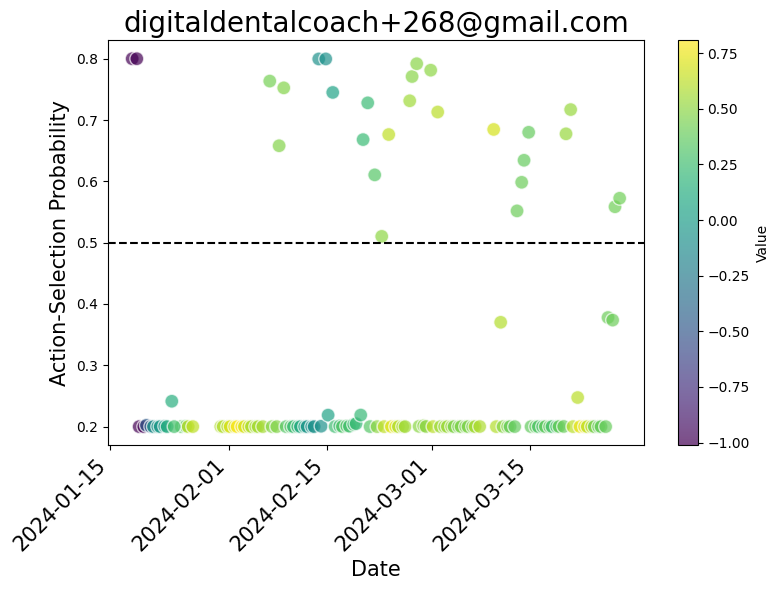

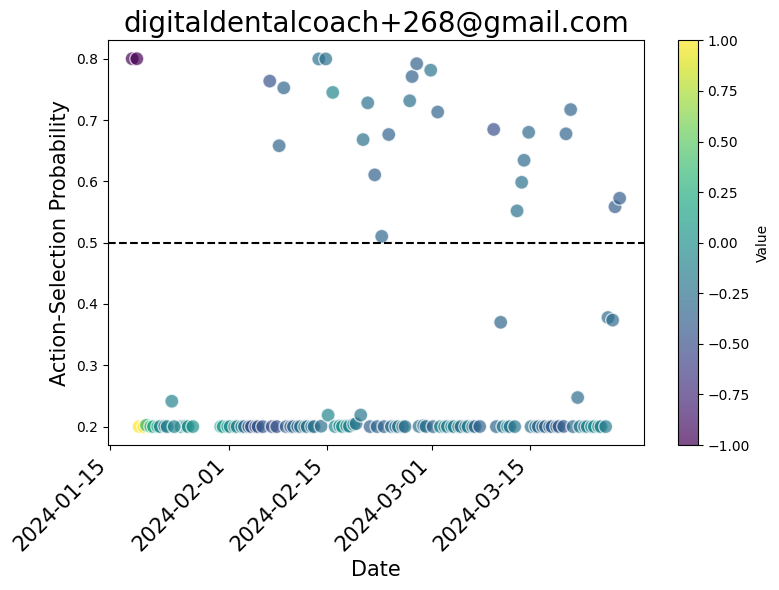

In [175]:
# TEST
test_user = "digitaldentalcoach+268@gmail.com"
test_user_df = get_user_data(MRT_DF, test_user)
test_user_df['decision_time'] = pd.to_datetime(test_user_df['decision_time'])
test_user_df = test_user_df[test_user_df['state_modif'] != 8]
dates = test_user_df['decision_time'].tolist()
b_bar_values = test_user_df['state_b_bar'].tolist()
a_bar_values = test_user_df['state_a_bar'].tolist()
probs = test_user_df['prob'].tolist()
plot_interesting_graph_real_valued(test_user, dates, b_bar_values, probs, f'../../figs/state_b_bar_plots/state_b_bar_{test_user}.pdf')
plot_interesting_graph_real_valued(test_user, dates, a_bar_values, probs, f'../../figs/state_a_bar_plots/state_a_bar_{test_user}.pdf')

### Generate Graphs
---

/var/folders/9n/sg342nsx01v38v7zgp161khr0000gn/T/ipykernel_38619/1017785894.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))  # Specify figure size (width, height) in inches


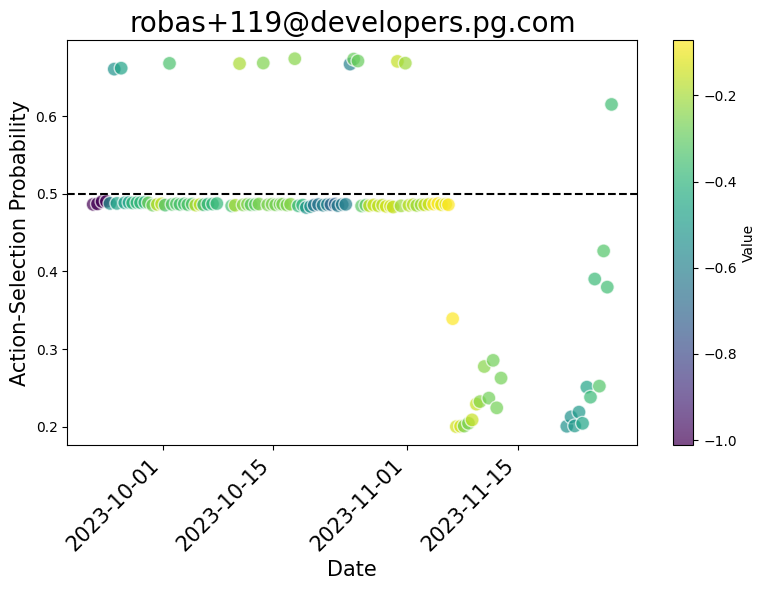

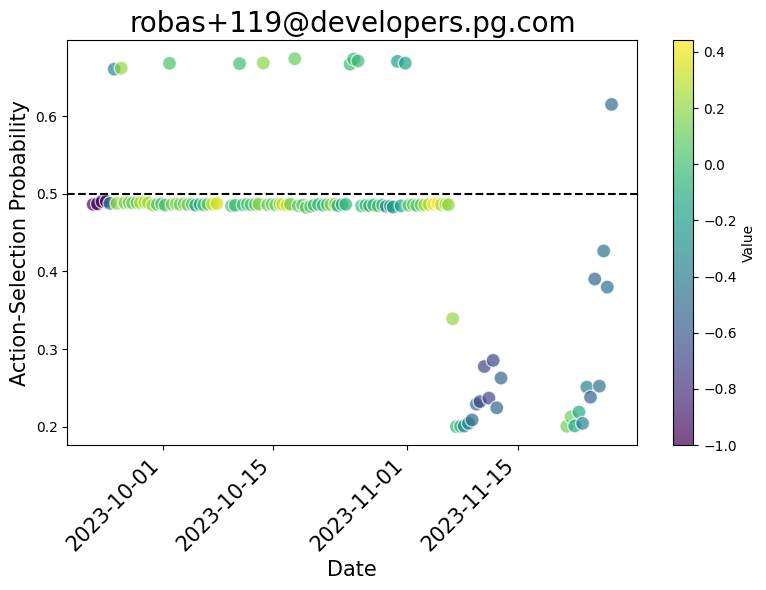

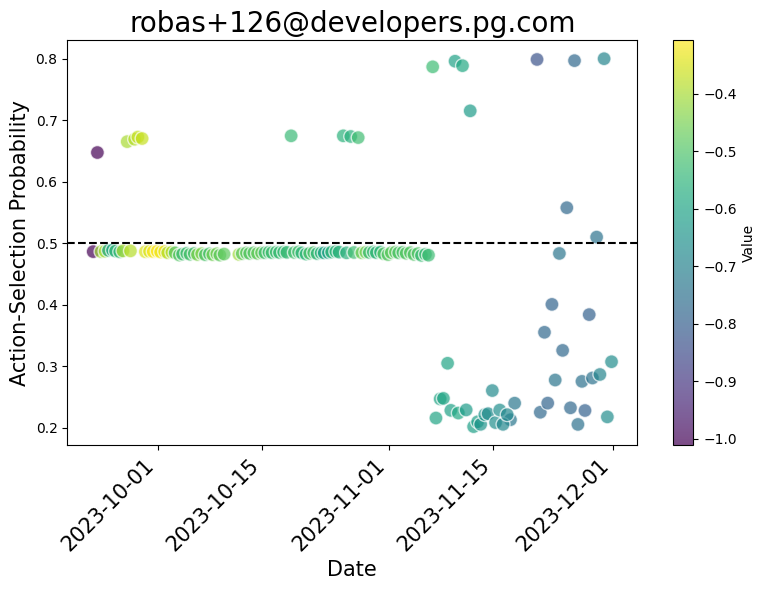

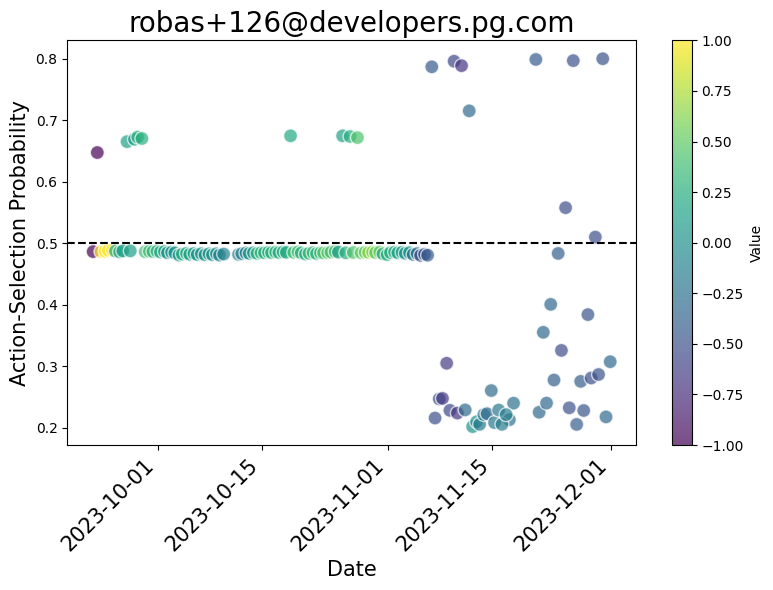

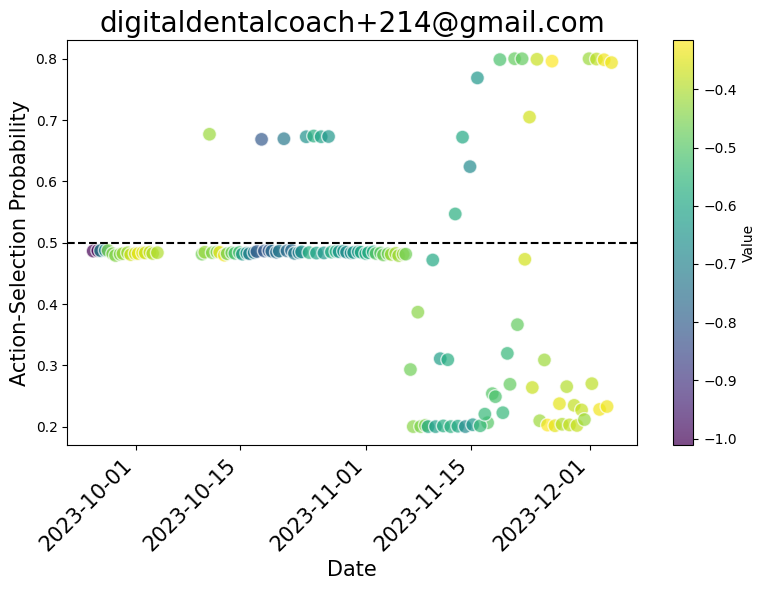

...

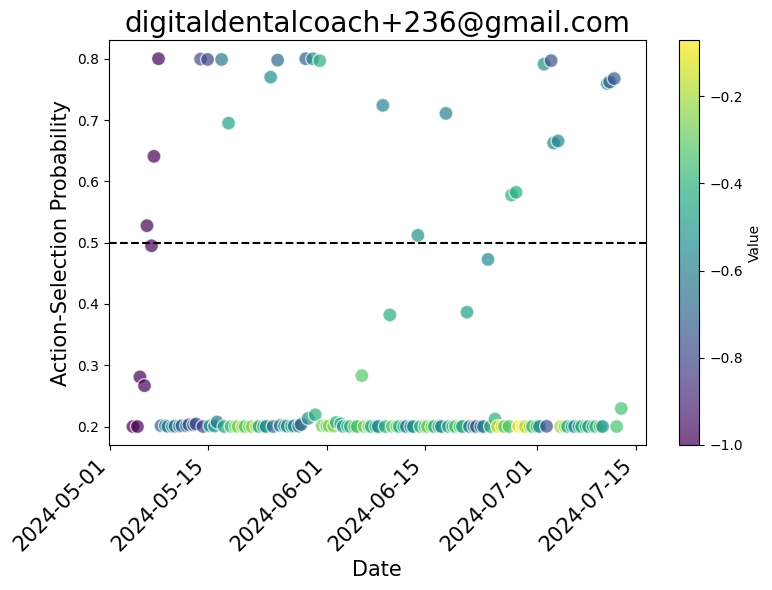

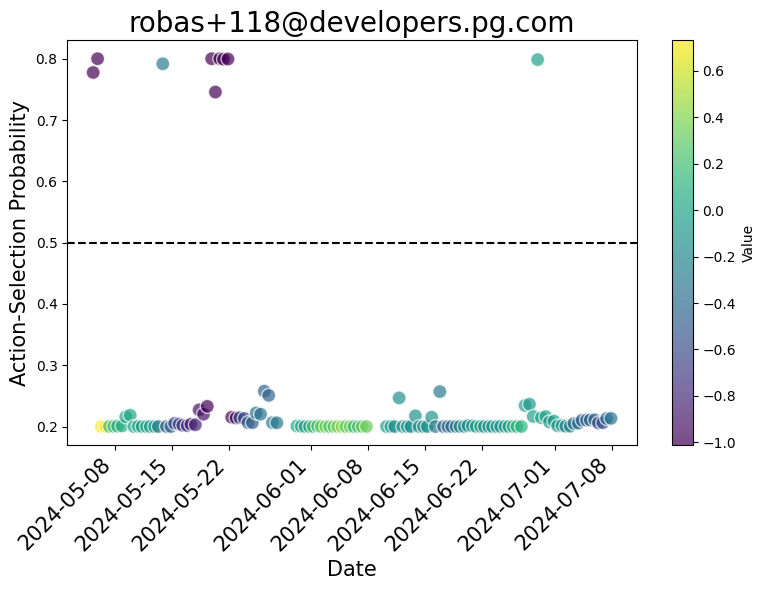

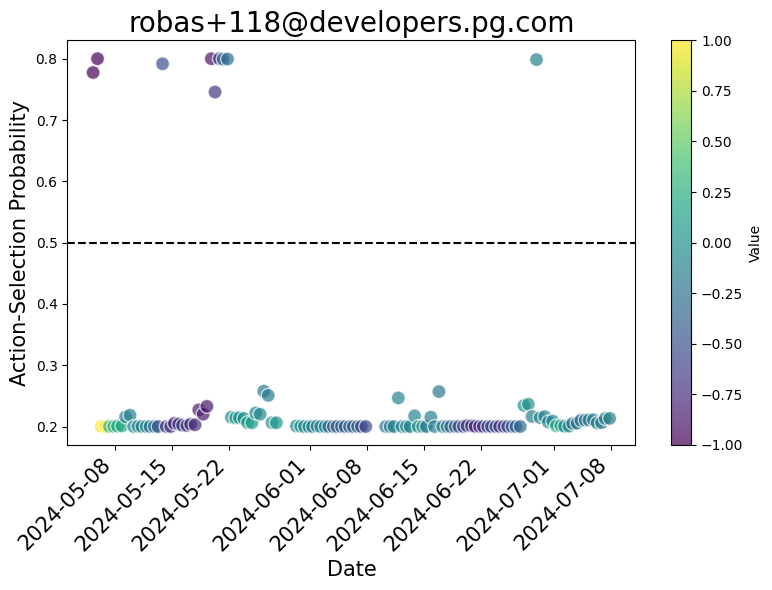

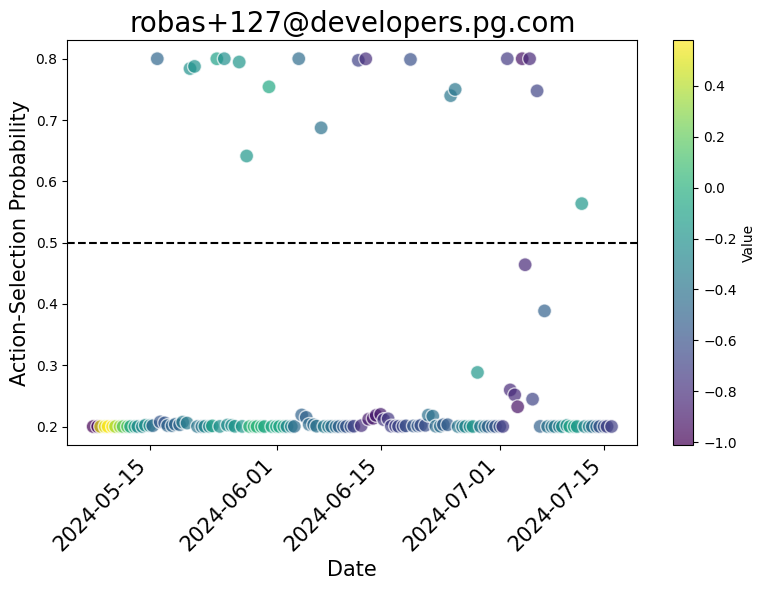

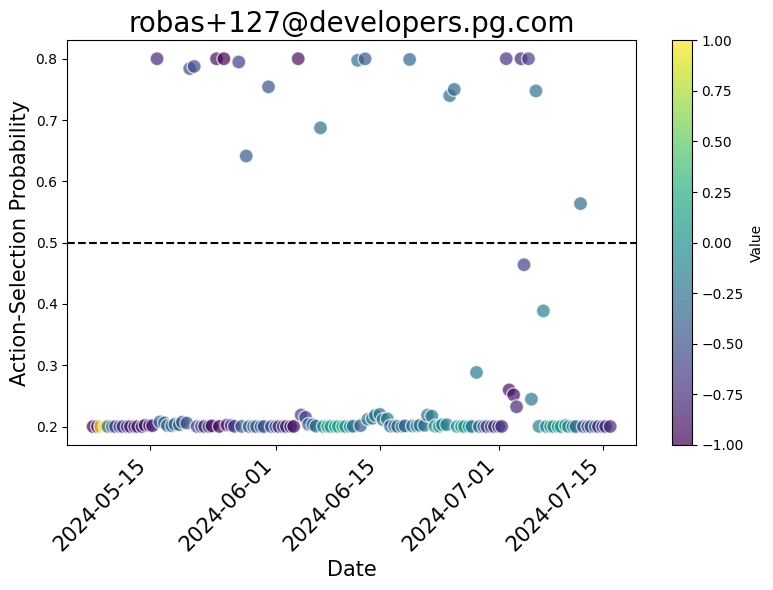

In [177]:
for user_id in MRT_USERS:
    user_df = get_user_data(MRT_DF, user_id)
    # filter for actions actually selected by the RL algorithm and not fallback fixed prob.
    user_df = user_df[user_df['state_modif'] != 8]
    user_df['decision_time'] = pd.to_datetime(user_df['decision_time'])
    dates = user_df['decision_time'].tolist()
    state_b_bar_values = user_df['state_b_bar'].tolist()
    state_a_bar_values = user_df['state_a_bar'].tolist()
    probs = user_df['prob'].tolist()
    plot_interesting_graph_real_valued(user_id, dates, state_b_bar_values, probs, f'../../figs/state_b_bar_plots/state_b_bar_{user_id}.pdf')
    plot_interesting_graph_real_valued(user_id, dates, state_a_bar_values, probs, f'../../figs/state_a_bar_plots/state_a_bar_{user_id}.pdf')

### Anna Comments
---

In [176]:
# Anna after manually checking
b_bar_ig_users = ['robas+152@developers.pg.com', 'robas+161@developers.pg.com', 'digitaldentalcoach+230@gmail.com', 'digitaldentalcoach+227@gmail.com', 'digitaldentalcoach+266@gmail.com', 'robas+178@developers.pg.com', 'digitaldentalcoach+268@gmail.com']
a_bar_ig_users = ['robas+152@developers.pg.com', 'robas+161@developers.pg.com', 'digitaldentalcoach+230@gmail.com', 'digitaldentalcoach+227@gmail.com', 'digitaldentalcoach+266@gmail.com', 'robas+178@developers.pg.com', 'digitaldentalcoach+268@gmail.com']

print(f"Anna found {len(b_bar_ig_users)} graphs interesting for state time of day")
print(f"Anna found {len(a_bar_ig_users)} graphs interesting for state prior day app engagement")

Anna found 7 graphs interesting for state time of day
Anna found 7 graphs interesting for state prior day app engagement


In [ ]:
source_folder = '../../figs/state_b_bar_plots/state_b_bar_{}.pdf'
destination_folder = '../../figs/interesting b_bar plots/state_b_bar_{}.pdf'

for user_id in b_bar_ig_users:
    # Construct full file paths
    source_file = source_folder.format(user_id)
    destination_file = destination_folder.format(user_id)
    
    # Check if the file exists in the source folder
    if os.path.exists(source_file):
        # Move the file
        shutil.move(source_file, destination_file)
        print(f"Moved {source_file} to {destination_folder}")
    else:
        print(f"{source_file} does not exist in the source folder")

In [183]:
source_folder = '../../figs/state_a_bar_plots/state_a_bar_{}.pdf'
destination_folder = '../../figs/interesting a_bar plots/state_a_bar_{}.pdf'

for user_id in a_bar_ig_users:
    # Construct full file paths
    source_file = source_folder.format(user_id)
    destination_file = destination_folder.format(user_id)
    
    # Check if the file exists in the source folder
    if os.path.exists(source_file):
        # Move the file
        shutil.move(source_file, destination_file)
        print(f"Moved {source_file} to {destination_folder}")
    else:
        print(f"{source_file} does not exist in the source folder")

Moved ../../figs/state_a_bar_plots/state_a_bar_robas+152@developers.pg.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf
Moved ../../figs/state_a_bar_plots/state_a_bar_robas+161@developers.pg.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf
Moved ../../figs/state_a_bar_plots/state_a_bar_digitaldentalcoach+230@gmail.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf
Moved ../../figs/state_a_bar_plots/state_a_bar_digitaldentalcoach+227@gmail.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf
Moved ../../figs/state_a_bar_plots/state_a_bar_digitaldentalcoach+266@gmail.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf
Moved ../../figs/state_a_bar_plots/state_a_bar_robas+178@developers.pg.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf
Moved ../../figs/state_a_bar_plots/state_a_bar_digitaldentalcoach+268@gmail.com.pdf to ../../figs/interesting a _bar plots/state_a_bar_{}.pdf


### Study-Level

In [178]:
# filter for actions actually selected by the RL algorithm and not fallback fixed prob.
filtered_mrt_df = MRT_DF[MRT_DF['state_modif'] != 8]
filtered_mrt_df['decision_time'] = pd.to_datetime(filtered_mrt_df['decision_time'])
dates = filtered_mrt_df['decision_time'].tolist()
probs = filtered_mrt_df['prob'].tolist()

/var/folders/9n/sg342nsx01v38v7zgp161khr0000gn/T/ipykernel_38619/3667336265.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_mrt_df['decision_time'] = pd.to_datetime(filtered_mrt_df['decision_time'])


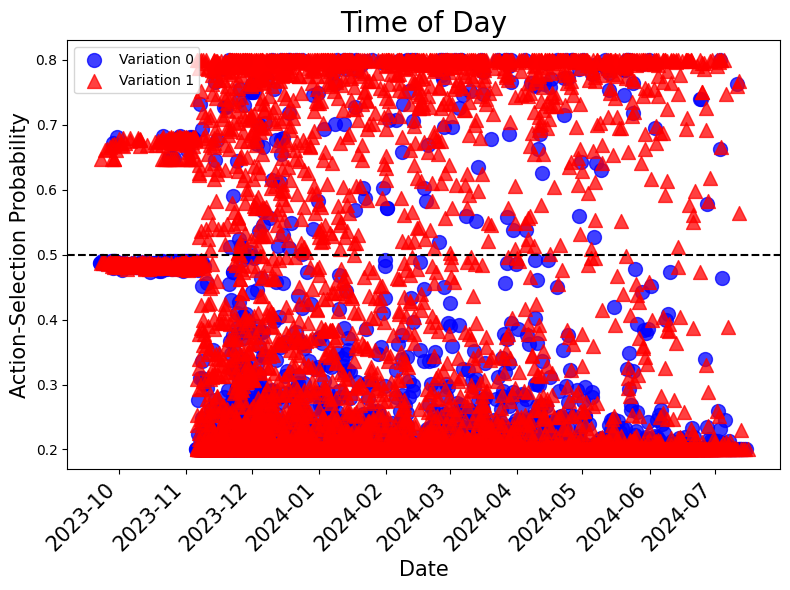

In [179]:
state_tod_values = filtered_mrt_df['state_tod'].tolist()
plot_interesting_graph_binary('Time of Day', dates, state_tod_values, probs, f'../../figs/state_tod_plots/state_tod_all.pdf')

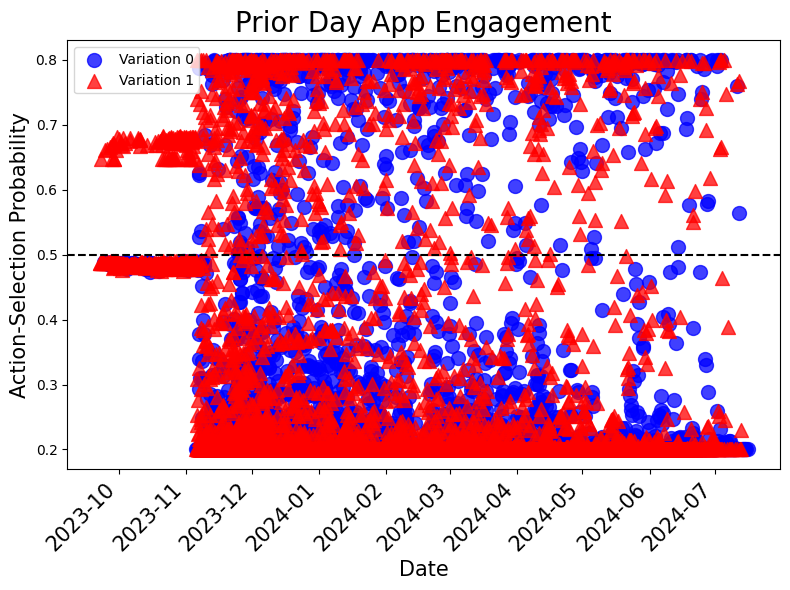

In [180]:
state_app_values = filtered_mrt_df['state_app_engage'].tolist()
plot_interesting_graph_binary('Prior Day App Engagement', dates, state_app_values, probs, f'../../figs/state_app_engage_plots/state_app_engage_all.pdf')

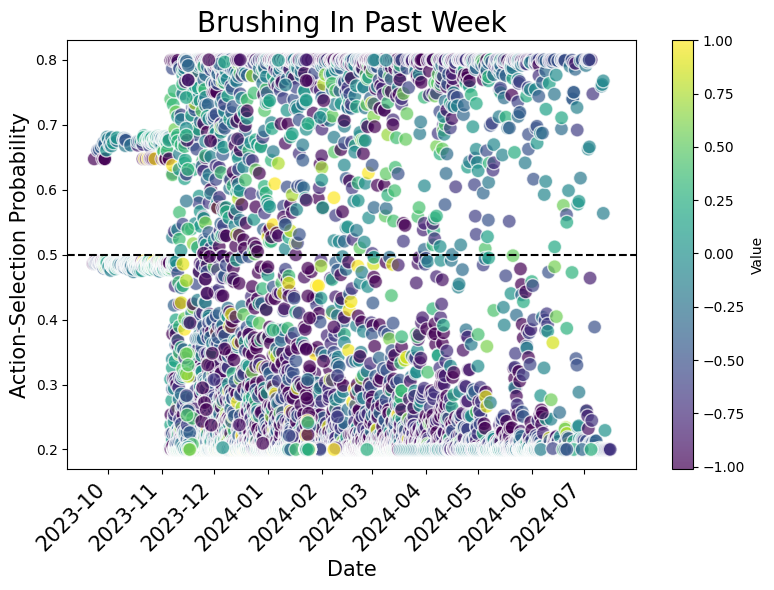

In [181]:
state_b_bar_values = filtered_mrt_df['state_b_bar'].tolist()
plot_interesting_graph_real_valued('Brushing In Past Week', dates, state_b_bar_values, probs, f'../../figs/state_b_bar_plots/state_b_bar_all.pdf')

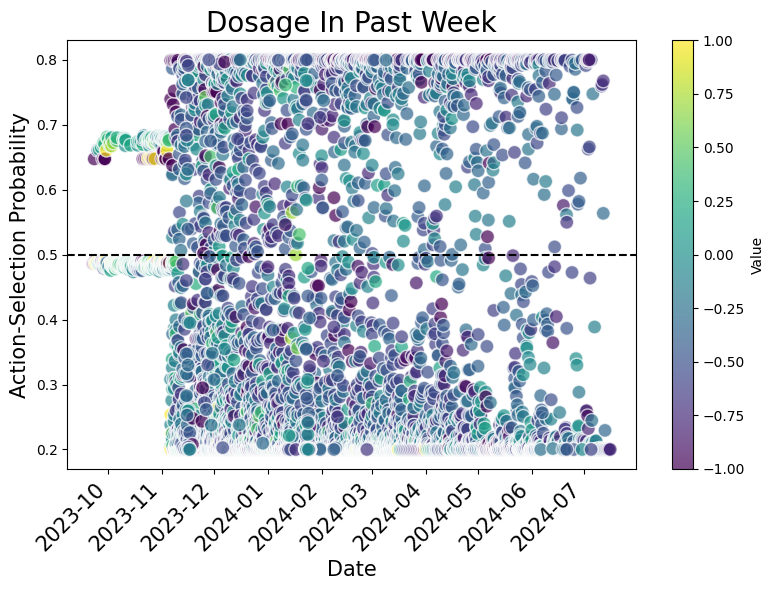

In [182]:
state_a_bar_values = filtered_mrt_df['state_a_bar'].tolist()
plot_interesting_graph_real_valued('Dosage In Past Week', dates, state_a_bar_values, probs, f'../../figs/state_a_bar_plots/state_a_bar_all.pdf')